In [3]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import plotly as py

from wordcloud import WordCloud, ImageColorGenerator, STOPWORDS
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from bs4 import BeautifulSoup
import requests
import json
import geopandas as gpd
from shapely.geometry import Point, Polygon
from geopandas.tools import sjoin
from plotly.offline import init_notebook_mode, plot, iplot
from PIL import Image
from os import path
import os

init_notebook_mode(connected=True)

In [4]:
new_titles = pd.DataFrame({
"v1": "Person in charge present, demonstrates knowledge, and performs duties (1)",
"v2": "City of Chicago Food Service Sanitation Certificate (2)",
"v3": "Management, food employee and conditional employee; knowledge, responsibilities and reporting (3)",
"v4": "Proper use of restriction and exclusion (4)",
"v5": "Procedures for responding to vomiting and diarrheal events (5)",
"v6": "Proper eating, tasting, drinking, or tobacco use (6)",
"v7": "No discharge from eyes, nose, and mouth (7)",
"v8": "Hands clean & properly washed (8)",
"v9": "No bare hand contact with RTE food or a pre-approved alternative procedure properly allowed (9)",
"v10": "Adequate handwashing sinks properly supplied and accessible (10)",
"v11": "Food obtained from approved source (11)",
"v12": "Food received at proper temperature (12)",
"v13": "Food in good condition, safe, & unadulterated (13)",
"v14": "Required records available: shellstock tags, parasite (14)",
"v15": "Food separated and protected (15)",
"v16": "Food-contact surfaces: cleaned & sanitized (16)",
"v17": "Proper disposition of returned, previously served, reconditioned & unsafe food (17)",
"v18": "Proper cooking time & temperatures (18)",
"v19": "Proper reheating procedures for hot holding (19)",
"v20": "Proper cooling time and temperature (20)",
"v21": "Proper hot holding temperatures (21)",
"v22": "Proper cold holding temperatures (22)",
"v23": "Proper date marking and disposition (23)",
"v24": "Time as a Public Health Control; procedures & records (24)",
"v25": "Consumer advisory provided for raw/undercooked food (25)",
"v26": "Pasteurized foods used; prohibited foods not offered (26)",
"v27": "Food additives: approved and properly used (27)",
"v28": "Toxic substances properly identified, stored, & used (28)",
"v29": "Compliance with variance/specialized process/HACCP (29)",
"v30": "Pasteurized eggs used where required (30)",
"v31": "Water & ice from approved source (31)",
"v32": "Variance obtained for specialized processing methods (32)",
"v33": "Proper cooling methods used; adequate equipment for temperature control (33)",
"v34": "Plant food properly cooked for hot holding (34)",
"v35": "Approved thawing methods used (35)",
"v36": "Thermometers provided & accurate (36)",
"v37": "Food properly labeled; original container (37)",
"v38": "Insects, rodents, & animals not present (38)",
"v39": "Contamination prevented during food preparation, storage & display (39)",
"v40": "Personal cleanliness (40)",
"v41": "Wiping cloths: properly used & stored (41)",
"v42": "Washing fruits & vegetables (42)",
"v43": "In-use utensils: properly stored (43)",
"v44": "Utensils, equipment & linens: properly stored, dried, & handled (44)",
"v45": "Single-use/single-service articles: properly stored & used (45)",
"v46": "Gloves used properly (46)",
"v47": "Food & non-food contact surfaces cleanable, properly designed, constructed & used (47)",
"v48": "Warewashing facilities: installed, maintained & used; test strips (48)",
"v49": "Non-food contact surfaces clean (49)",
"v50": "Hot & cold water available; adequate pressure (50)",
"v51": "Plumbing installed; proper backflow devices (51)",
"v52": "Sewage & waste water properly disposed (52)",
"v53": "Toilet facilities: properly constructed, supplied, & cleaned (53)",
"v54": "Garbage & refuse properly disposed; facilities maintained (54)",
"v55": "Physical facilities installed, maintained & clean (55)",
"v56": "Adequate ventilation & lighting; designated areas used (56)",
"v57": "IN OUT     All food employees have food handler training (57)",
"v58": "IN OUT     Allergen training as required (58)",
"v59": "Previous priority foundation violation corrected (59)",
"v60": "Previous core violation corrected (60)",
"v61": "Summary Report displayed and visible to the public (61)",
"v62": "Compliance with Clean Indoor Air Ordinance (62)",
"v63": "Removal of Suspension Sign (63)",
}, index=[0])

In [5]:
old_titles = pd.DataFrame({
    "v1": "Approved food sources (1)",
    "v2": "Hot/cold storage facilities (2)",
    "v3": "Hot/cold storage temperatures (3)",
    "v4": "Contaminant protection (4)",
    "v5": "No sick handlers (5)",
    "v6": "Proper hand washing (6)",
    "v7": "Proper utensil washing (7)",
    "v8": "Proper sanitizing solution (8)",
    "v9": "Hot/cold water supply (9)",
    "v10": "Waste water disposal (10)",
    "v11": "Adequate toilet facilities (11)",
    "v12": "Adequate hand washing facilities (12)",
    "v13": "Control of rodents, other pests (13)",
    "v14": "Correct serious violations (14)",
    "v15": "No re-served food (15)",
    "v16": "Protection from contamination (16)",
    "v17": "Proper thawing (17)",
    "v18": "Pest control (18)",
    "v19": "Proper garbage area (19)",
    "v20": "Proper garbage storage (20)",
    "v21": "Oversight of hazardous food (21)",
    "v22": "Dishwasher maintenance (22)",
    "v23": "Scrape before washing (23)",
    "v24": "Proper dishwashers (24)",
    "v25": "Minimize toxic materials (25)",
    "v26": "Adequate customer toilets (26)",
    "v27": "Supplied toilet facilities (27)",
    "v28": "Visible inspection report (28)",
    "v29": "Correct minor violations (29)",
    "v30": "Labelled containers (30)",
    "v31": "Sterile utensils (31)",
    "v32": "Clean, maintain equipment (32)",
    "v33": "Clean, sanitize utensils (33)",
    "v34": "Clean, maintain floor (34)",
    "v35": "Maintain walls & ceiling (35)",
    "v36": "Proper lighting (36)",
    "v37": "Toilet rooms vented (37)",
    "v38": "Proper venting, plumbing (38)",
    "v39": "Linen, clothing storage (39)",
    "v40": "Proper thermometers (40)",
    "v41": "Clean facilities, store supplies (41)",
    "v42": "Ice handling, hairnets, clothes (42)",
    "v43": "Ice equipment storage (43)",
    "v44": "Restrict prep area traffic (44)",
    "v70": "Restrict smoking (70)"
}, index=[0])


In [6]:
new_rules_cats = dict()


#new_rules_cats['HEALTH CODE VIOLATIONS'] = (0, 63)
#new_rules_cats['FOODBORNE ILLNESS RISK FACTORS AND PUBLIC HEALTH INTERVENTIONS'] = (0,29)
#new_rules_cats['GOOD RETAIL PRACTICES'] = (29, 63)

new_rules_cats['SUPERVISION'] = (0,2)
new_rules_cats['EMPLOYEE HEALTH'] = (2,5)
new_rules_cats['GOOD HYGIENIC PRACTICES'] = (5,7)
new_rules_cats['PREVENTING CONTAMINATION BY HANDS'] = (7, 10)
new_rules_cats['APPROVED SOURCE'] = (10, 14)
new_rules_cats['PROTECTION FROM CONTAMINATION'] = (14, 17)
new_rules_cats['TIME/TEMPERATURE CONTROL FOR SAFETY '] = (17, 24)
new_rules_cats['CONSUMER ADVISORY'] = (24, 25)
new_rules_cats['HIGHLY SUSCEPTIBLE POPULATIONS'] = (25, 26)
new_rules_cats['FOOD/COLOR ADDITIVES AND TOXIC SUBSTANCES'] = (26, 28)
new_rules_cats['CONFORMANCE WITH APPROVED PROCEDURES'] = (28, 29)
new_rules_cats['SAFE FOOD AND WATER'] = (29, 32)
new_rules_cats['FOOD TEMPERATURE CONTROL'] = (32, 36)
new_rules_cats['FOOD IDENTIFICATION'] = (36, 37)
new_rules_cats['PREVENTION OF FOOD CONTAMINATION  ']= (37, 42)
new_rules_cats['PROPER USE OF UTENSILS'] = (42, 46)
new_rules_cats['UTENSILS, EQUIPMENT, AND VENDING'] = (46, 49)
new_rules_cats['PHYSICAL FACILITIES'] = (49, 56)
new_rules_cats['EMPLOYEE TRAINING'] = (56, 58)
new_rules_cats['CITY OF CHICAGO ORDINANCE COMPLIANCE'] = (58, 63)

In [7]:
pd.set_option('display.max_columns', 500)
inspections = pd.read_csv("data/food-inspections.csv")
#inspections.head()

In [8]:
inspections["date"] = pd.to_datetime(inspections["Inspection Date"])

# drop rows with missing information
inspections = inspections.dropna(subset=["Inspection Date", "License #", "Latitude", "Longitude", 'Facility Type'])

# there are duplicates in the dataset
inspections = inspections.drop_duplicates("Inspection ID")

# remove dirty rows
inspections = inspections[inspections['License #'] != 0.0]

# only consider successful inspections
inspections = inspections[~inspections.Results.isin(["Out of Business", "Business Not Located", "No Entry", "Not Ready"])]

In [9]:
"""
Inspection type: An inspection can be one of the following types: canvass, the most
common type of inspection performed at a frequency relative to the risk of the
establishment; consultation, when the inspection is done at the request of the owner
prior to the opening of the establishment; complaint, when the inspection is done in
response to a complaint against the establishment; license, when the inspection is done
as a requirement for the establishment to receive its license to operate; suspect food
poisoning, when the inspection is done in response to one or more persons claiming to
have gotten ill as a result of eating at the establishment (a specific type of complaint-
based inspection); task-force inspection, when an inspection of a bar or tavern is done.
Re-inspections can occur for most types of these inspections and are indicated as such. 
"""
#different types of inspections
inspections.groupby('Inspection Type').count().sort_values(by = 'Latitude', ascending = False).head(10)

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Results,Violations,Latitude,Longitude,Location,Historical Wards 2003-2015,Zip Codes,Community Areas,Census Tracts,Wards,date
Inspection Type,,,,,,,,,,,,,,,,,,,,,,
Canvass,80928,80928,80624,80928,80928,80928,80928,80903,80920,80922,80928,80928,77940,80928,80928,80928,0,0,0,0,0,80928
License,23133,23133,22385,23133,23133,23131,23133,23100,23116,23123,23133,23133,15700,23133,23133,23133,0,0,0,0,0,23133
Canvass Re-Inspection,20014,20014,19944,20014,20014,20014,20014,20008,20012,20010,20014,20014,14507,20014,20014,20014,0,0,0,0,0,20014
Complaint,17158,17158,17086,17158,17158,17158,17158,17150,17157,17157,17158,17158,16792,17158,17158,17158,0,0,0,0,0,17158
License Re-Inspection,8781,8781,8428,8781,8781,8781,8781,8764,8775,8775,8781,8781,3730,8781,8781,8781,0,0,0,0,0,8781
Complaint Re-Inspection,7341,7341,7309,7341,7341,7341,7341,7339,7341,7341,7341,7341,5241,7341,7341,7341,0,0,0,0,0,7341
Short Form Complaint,6559,6559,6529,6559,6559,6559,6559,6557,6559,6558,6559,6559,4847,6559,6559,6559,0,0,0,0,0,6559
Suspected Food Poisoning,835,835,832,835,835,835,835,835,835,835,835,835,814,835,835,835,0,0,0,0,0,835
Consultation,632,632,624,632,632,630,632,632,632,632,632,632,382,632,632,632,0,0,0,0,0,632


Recognize below Canvass Re-Inspection happens after a failed Canvass inspection.

In [10]:
#inspections[inspections['Inspection Type'] == 'Canvass'].groupby('License #').count().sort_values('Risk', ascending = False)
inspections[inspections['License #'] == 14616.0]

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Historical Wards 2003-2015,Zip Codes,Community Areas,Census Tracts,Wards,date
7215,2288971,"ILLINOIS SPORTSERVICE, INC.",GUARANTEED RATE FIELD,14616.0,STADIUM,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2019-05-16T00:00:00.000,Canvass Re-Inspection,Pass w/ Conditions,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...",41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2019-05-16
22560,2181546,"ILLINOIS SPORTSERVICE, INC.",GUARANTEED RATE FIELD,14616.0,STADIUM,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2018-06-18T00:00:00.000,Canvass Re-Inspection,Pass,32. FOOD AND NON-FOOD CONTACT SURFACES PROPERL...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2018-06-18
22720,2181490,"ILLINOIS SPORTSERVICE, INC.",GUARANTEED RATE FIELD,14616.0,STADIUM,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2018-06-14T00:00:00.000,Canvass,Fail,2. FACILITIES TO MAINTAIN PROPER TEMPERATURE -...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2018-06-14
42443,2064598,"ILLINOIS SPORTSERVICE, INC.",GUARANTEED RATE FIELD,14616.0,STADIUM,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2017-06-20T00:00:00.000,Canvass Re-Inspection,Pass,32. FOOD AND NON-FOOD CONTACT SURFACES PROPERL...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2017-06-20
42709,2064419,"ILLINOIS SPORTSERVICE, INC.",GUARANTEED RATE FIELD,14616.0,STADIUM,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2017-06-15T00:00:00.000,Canvass,Fail,3. POTENTIALLY HAZARDOUS FOOD MEETS TEMPERATUR...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2017-06-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190965,78380,ILLINOIS SPORTSERVICE INC,BBQ BEEF (#148),14616.0,KIOSK,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2010-03-25T00:00:00.000,Canvass,Pass,NaN,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2010-03-25
190966,78374,ILLINOIS SPORTSERVICE INC,LITTLE LOUIE'S ALL STAR STAND #529,14616.0,Restaurant,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2010-03-25T00:00:00.000,Canvass,Pass,NaN,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2010-03-25
190967,231285,ILLINOIS SPORTSERVICE INC,BURGER BARN- (#112),14616.0,KIOSK,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2010-03-25T00:00:00.000,Canvass,Pass w/ Conditions,12. HAND WASHING FACILITIES: WITH SOAP AND SAN...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2010-03-25
190971,74355,ILLINOIS SPORTSERVICE INC,MOOSES DOGS AND POLISH 10 (#538),14616.0,KIOSK,Risk 2 (Medium),333 W 35TH ST,CHICAGO,IL,60616.0,2010-03-25T00:00:00.000,Canvass,Pass,32. FOOD AND NON-FOOD CONTACT SURFACES PROPERL...,41.830784,-87.635296,"{'longitude': '41.83078366228312', 'latitude':...",NaN,NaN,NaN,NaN,NaN,2010-03-25


In [11]:
#then only consider Canvass inspections. (not complaints, license or re inspections)
inspections = inspections[inspections['Inspection Type'] == "Canvass"]

In [359]:

def drawPieChart(inspections_df):
    facility_counts_series = inspections_df['Facility Type'].value_counts()
    
    #gather these under 'other' category
    facility_mask = facility_counts_series < inspections_df.shape[0]* 0.017
    facility_other_count = facility_counts_series[facility_mask].sum()
    
    facility_counts_final_series = facility_counts_series[~facility_mask]
    facility_counts_final_series['Other'] =  facility_other_count
    
    labels = facility_counts_final_series.keys()
    values = facility_counts_final_series.values
    
    
    fig = go.Figure(data=[go.Pie(labels=labels, values=values)])
    fig.update_layout(legend = dict(x = +0.75, ))
    
    other_wordcloud = WordCloud(background_color = 'white', width = 2000, height = 1000).generate_from_frequencies(dict(facility_counts_series[facility_mask]))
    return fig, other_wordcloud

In [360]:
fig, other_wordcloud = drawPieChart(inspections)

In [336]:
iplot(fig)

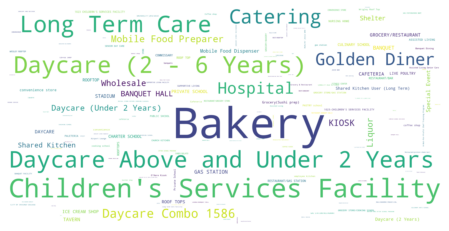

In [366]:
plt.rcParams['figure.figsize'] = (8, 4)
image_colors = ImageColorGenerator(alice_coloring)

plt.imshow(other_wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [58]:
#only consider restaurants and grocery stores because the other facilities like hospitals and schools are likely to be under more strict regulations.
inspections = inspections[inspections['Facility Type'].isin(["Restaurant", "Grocery Store"])]

In [121]:
#add n_violations column
inspections['n_violations'] = inspections.Violations.apply(lambda v: len(v.split(' | ')) if type(v) == str else 0)
inspections.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Historical Wards 2003-2015,Zip Codes,Community Areas,Census Tracts,Wards,date,n_violations
1,2320342,YOLK TEST KITCHEN,YOLK TEST KITCHEN,2589655.0,Restaurant,Risk 1 (High),1767 N MILWAUKEE AVE,CHICAGO,IL,60647.0,2019-10-23T00:00:00.000,Canvass,Pass w/ Conditions,23. PROPER DATE MARKING AND DISPOSITION - Comm...,41.913588,-87.682203,"{'longitude': '41.9135877900482', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-23,4
5,2320261,CRAZY BIRD,CRAZY BIRD,2616198.0,Restaurant,Risk 1 (High),1160 W GRAND AVE,CHICAGO,IL,60642.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,16. FOOD-CONTACT SURFACES: CLEANED & SANITIZED...,41.891193,-87.657055,"{'longitude': '41.891193484441246', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,4
7,2320298,HAISOUS,CA PHE DA,2464411.0,Restaurant,Risk 1 (High),1800-1802 S CARPENTER ST,CHICAGO,IL,60608.0,2019-10-22T00:00:00.000,Canvass,Pass,47. FOOD & NON-FOOD CONTACT SURFACES CLEANABLE...,41.857963,-87.653358,"{'longitude': '41.8579631274509', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,2
10,2320229,HIMALAYAN SHERPA KITCHEN,HIMALAYAN SHERPA KITCHEN,2670751.0,Restaurant,Risk 1 (High),2701 W LAWRENCE AVE,CHICAGO,IL,60625.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.968442,-87.696304,"{'longitude': '41.968442053562335', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,10
16,2320311,MAXWELL STREET EXPRESS,MAXWELL STREET EXPRESS,1647725.0,Restaurant,Risk 2 (Medium),1058 W 87TH ST,CHICAGO,IL,60620.0,2019-10-22T00:00:00.000,Canvass,Fail,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.736080,-87.650859,"{'longitude': '41.7360797687383', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,6


In [133]:
#add the list of violations committed. may contain duplicates 
inspections['vs_committed'] = inspections.Violations.apply(lambda v: [ x.split('.')[0] for x in v.split(' | ')] if type(v) == str else [])
inspections.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Historical Wards 2003-2015,Zip Codes,Community Areas,Census Tracts,Wards,date,n_violations,vs_committed
1,2320342,YOLK TEST KITCHEN,YOLK TEST KITCHEN,2589655.0,Restaurant,Risk 1 (High),1767 N MILWAUKEE AVE,CHICAGO,IL,60647.0,2019-10-23T00:00:00.000,Canvass,Pass w/ Conditions,23. PROPER DATE MARKING AND DISPOSITION - Comm...,41.913588,-87.682203,"{'longitude': '41.9135877900482', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-23,4,"[23, 25, 37, 47]"
5,2320261,CRAZY BIRD,CRAZY BIRD,2616198.0,Restaurant,Risk 1 (High),1160 W GRAND AVE,CHICAGO,IL,60642.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,16. FOOD-CONTACT SURFACES: CLEANED & SANITIZED...,41.891193,-87.657055,"{'longitude': '41.891193484441246', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,4,"[16, 23, 41, 53]"
7,2320298,HAISOUS,CA PHE DA,2464411.0,Restaurant,Risk 1 (High),1800-1802 S CARPENTER ST,CHICAGO,IL,60608.0,2019-10-22T00:00:00.000,Canvass,Pass,47. FOOD & NON-FOOD CONTACT SURFACES CLEANABLE...,41.857963,-87.653358,"{'longitude': '41.8579631274509', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,2,"[47, 55]"
10,2320229,HIMALAYAN SHERPA KITCHEN,HIMALAYAN SHERPA KITCHEN,2670751.0,Restaurant,Risk 1 (High),2701 W LAWRENCE AVE,CHICAGO,IL,60625.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.968442,-87.696304,"{'longitude': '41.968442053562335', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,10,"[5, 23, 37, 47, 47, 47, 49, 53, 55, 56]"
16,2320311,MAXWELL STREET EXPRESS,MAXWELL STREET EXPRESS,1647725.0,Restaurant,Risk 2 (Medium),1058 W 87TH ST,CHICAGO,IL,60620.0,2019-10-22T00:00:00.000,Canvass,Fail,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.736080,-87.650859,"{'longitude': '41.7360797687383', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,6,"[5, 38, 47, 49, 55, 55]"


In [157]:
inspections['vs_comments'] = inspections.Violations.apply(lambda v: [ x.split('Comments: ')[1] if len(x.split('Comments: ')) == 2 else '' for x in v.split(' | ')] if type(v) == str else [])
inspections.head()

,Inspection ID,DBA Name,AKA Name,License #,Facility Type,Risk,Address,City,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Historical Wards 2003-2015,Zip Codes,Community Areas,Census Tracts,Wards,date,n_violations,vs_committed,vs_comments
1,2320342,YOLK TEST KITCHEN,YOLK TEST KITCHEN,2589655.0,Restaurant,Risk 1 (High),1767 N MILWAUKEE AVE,CHICAGO,IL,60647.0,2019-10-23T00:00:00.000,Canvass,Pass w/ Conditions,23. PROPER DATE MARKING AND DISPOSITION - Comm...,41.913588,-87.682203,"{'longitude': '41.9135877900482', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-23,4,"[23, 25, 37, 47]",[OBSERVED SOME TCS FOOD NOT PROPERLY DATED IN ...
5,2320261,CRAZY BIRD,CRAZY BIRD,2616198.0,Restaurant,Risk 1 (High),1160 W GRAND AVE,CHICAGO,IL,60642.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,16. FOOD-CONTACT SURFACES: CLEANED & SANITIZED...,41.891193,-87.657055,"{'longitude': '41.891193484441246', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,4,"[16, 23, 41, 53]",[OBSERVED LOW TEMPERATURE DISH MACHINE NOT PRO...
7,2320298,HAISOUS,CA PHE DA,2464411.0,Restaurant,Risk 1 (High),1800-1802 S CARPENTER ST,CHICAGO,IL,60608.0,2019-10-22T00:00:00.000,Canvass,Pass,47. FOOD & NON-FOOD CONTACT SURFACES CLEANABLE...,41.857963,-87.653358,"{'longitude': '41.8579631274509', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,2,"[47, 55]",[OBSERVED THE CUTTING BOARDS IN THE BAR AREA S...
10,2320229,HIMALAYAN SHERPA KITCHEN,HIMALAYAN SHERPA KITCHEN,2670751.0,Restaurant,Risk 1 (High),2701 W LAWRENCE AVE,CHICAGO,IL,60625.0,2019-10-22T00:00:00.000,Canvass,Pass w/ Conditions,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.968442,-87.696304,"{'longitude': '41.968442053562335', 'latitude'...",NaN,NaN,NaN,NaN,NaN,2019-10-22,10,"[5, 23, 37, 47, 47, 47, 49, 53, 55, 56]",[FOUND PROCEDURE/PLAN FOR RESPONDING TO VOMITI...
16,2320311,MAXWELL STREET EXPRESS,MAXWELL STREET EXPRESS,1647725.0,Restaurant,Risk 2 (Medium),1058 W 87TH ST,CHICAGO,IL,60620.0,2019-10-22T00:00:00.000,Canvass,Fail,5. PROCEDURES FOR RESPONDING TO VOMITING AND D...,41.736080,-87.650859,"{'longitude': '41.7360797687383', 'latitude': ...",NaN,NaN,NaN,NaN,NaN,2019-10-22,6,"[5, 38, 47, 49, 55, 55]",[FOUND NO PROCEDURES OR CLEAN UP KIT FOR RESPO...


In [163]:
old_code_inspections = inspections[(inspections.date < pd.Timestamp(2018, 7 , 1))]
new_code_inspections = inspections[(inspections.date >= pd.Timestamp(2018, 7 , 1))]

In [177]:
def compute_violations_matrix(inspections_df):
    
    def helper(vs_committed_list):
        values_row = pd.Series([])
        for v_number in vs_committed_list:
            index = 'v' + v_number
            values_row[index] = values_row.get(index, 0) + 1
        return values_row
            
    return inspections_df['vs_committed'].apply(helper).fillna(0)



In [217]:
old_codes_violation_matrix = compute_violations_matrix(old_code_inspections[:5000])
new_codes_violation_matrix = compute_violations_matrix(new_code_inspections[:5000])

old_codes_violation_matrix['date'] = old_code_inspections[:5000].date
new_codes_violation_matrix['date'] = new_code_inspections[:5000].date

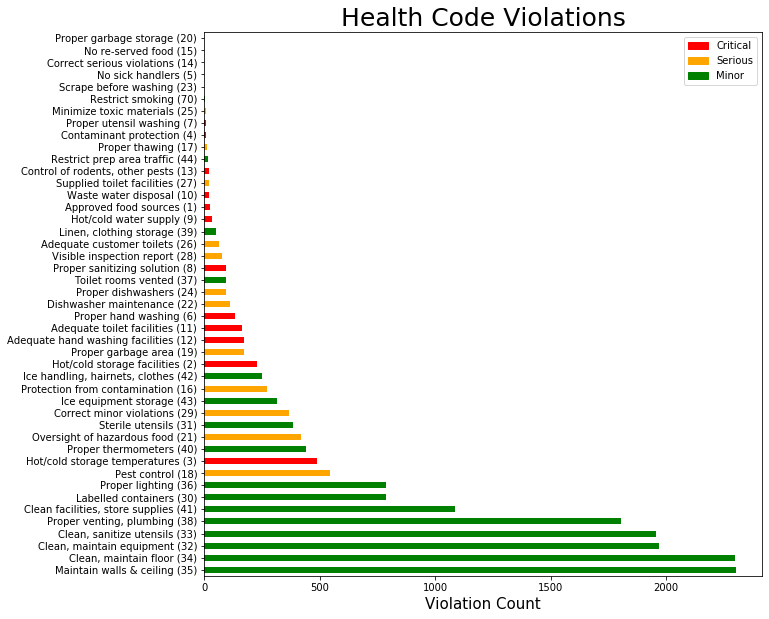

In [221]:
def draw_violation_count_distribution_old(violation_matrix):
    critical_columns = [("v" + str(num)) for num in range(1, 15)]
    serious_columns = [("v" + str(num)) for num in range(15, 30)]
    minor_columns = [("v" + str(num)) for num in range(30, 45)]
    minor_columns.append("v70")

    violations_df = pd.DataFrame(violation_matrix, columns= critical_columns + serious_columns + minor_columns).rename(columns=old_titles.iloc[0])
    violations_sums = violations_df.sum()
    colors = ["red"] * 14 + ["orange"] * 15 + ["green"] *16

    violations_sums_sorted = pd.DataFrame({"sums": violations_sums, "colors": colors}).sort_values("sums")

    ax = violations_sums_sorted.sums.plot(kind="barh", color=violations_sums_sorted.colors)
    ax.set_title("Health Code Violations", fontsize=25)
    ax.set_xlabel("Violation Count", fontsize=15)
    ax.invert_yaxis()
    red_patch = mpatches.Patch(color='red', label='Critical')
    orange_patch = mpatches.Patch(color='orange', label='Serious')
    green_patch = mpatches.Patch(color='green', label='Minor')
    plt.legend(handles=[red_patch, orange_patch, green_patch])
    plt.show()

draw_violation_count_distribution_old(old_codes_violation_matrix)

In [222]:
def compute_treemap_values_old(old_codes_violation_matrix):

    
    #create violation df
    critical_columns = [("v" + str(num)) for num in range(1, 15)]
    serious_columns = [("v" + str(num)) for num in range(15, 30)]
    minor_columns = [("v" + str(num)) for num in range(30, 45)]
    minor_columns.append("v70")
    columns = critical_columns + serious_columns + minor_columns
    
    violations_df = pd.DataFrame(old_codes_violation_matrix, columns=columns).rename(columns = old_titles.iloc[0])
    
    #count occurences of each violation
    violations_sums = violations_df.sum()
    
    
    critical_violations_sum = violations_sums[:14].sum()
    serious_violations_sum = violations_sums[14:29].sum()
    minor_violations_sum = violations_sums[29:].sum()
    all_violations_sum = critical_violations_sum + serious_violations_sum + minor_violations_sum
    
    labels = ["Health Code Violations", "Critical", "Serious", "Minor"] + old_titles.values[0][:14].tolist() + old_titles.values[0][14:29].tolist() + old_titles.values[0][29:].tolist()
    parents = ["", "Health Code Violations", "Health Code Violations", "Health Code Violations"] + 14 * ['Critical'] + 15 * ['Serious'] + 16 * ['Minor']
    values = [all_violations_sum , critical_violations_sum, serious_violations_sum, minor_violations_sum] + violations_sums[:14].tolist() + violations_sums[14:29].tolist() + violations_sums[29:].tolist()

    
    
    return labels, parents, values

def compute_treemap_values_new(new_codes_violation_matrix): 
    violations_df = pd.DataFrame(new_codes_violation_matrix, columns=['v' + str(num) for num in range(1,64)]).rename(columns = new_titles.iloc[0])


    labels =  ['HEALTH CODE VIOLATIONS', 'FOODBORNE ILLNESS RISK FACTORS AND PUBLIC HEALTH INTERVENTIONS', 'GOOD RETAIL PRACTICES']
    parents = ["", 'HEALTH CODE VIOLATIONS', 'HEALTH CODE VIOLATIONS']
    violations_sums = violations_df.sum()
    values = [violations_sums[0:63].sum(), violations_sums[0:29].sum(), violations_sums[29:63].sum()]
    
#new_rules_cats['HEALTH CODE VIOLATIONS'] = (0, 63)
#new_rules_cats['FOODBORNE ILLNESS RISK FACTORS AND PUBLIC HEALTH INTERVENTIONS'] = (0,29)
#new_rules_cats['GOOD RETAIL PRACTICES'] = (29, 63)

    for l in list(new_rules_cats.keys()):
            t1, t2 = new_rules_cats[l]
            parents.append('GOOD RETAIL PRACTICES' if t1 >= 29 else 'FOODBORNE ILLNESS RISK FACTORS AND PUBLIC HEALTH INTERVENTIONS')
            labels.append(l)
            values.append(violations_sums[t1:t2].sum())

    for key,val in new_rules_cats.items():
        start, end = val
        labels += violations_df.columns.tolist()[start:end]
        parents += [key] * (end - start)
        values += violations_sums[start:end].values.tolist()
        
    return labels, parents, values
    

def generate_treemap(l, p, v):
    return go.Treemap(
        branchvalues = 'total',
        labels = l,
        parents = p,
        values =  v,
        textinfo = "label+value",
        #texttemplate = "%{label} <br> # of violations recorded: %{value}",
        #textinfo = "Code: %{label}",
        hoverinfo='text+percent parent+percent root+label+value',
        #hovertemplate = '%{label}',
        maxdepth=2,
        #marker_colors = ["pink", "darkred", "darkgreen", "lightgreen"]
        marker_colorscale = 'Blues',
        #textfont = {'size': 20}
        )

def create_traces():

    traces = []
    
    for year in range(2010, 2019):
        l,p,v = compute_treemap_values_old(old_codes_violation_matrix[old_codes_violation_matrix.date.dt.year == year])
        treemap = generate_treemap(l, p, v)
        traces.append(treemap)
        
    for year in range(2018, 2020):
        l,p,v = compute_treemap_values_new(new_codes_violation_matrix[new_codes_violation_matrix.date.dt.year == year])
        
        treemap = generate_treemap(l,p,v)
        traces.append(treemap)
    

    

    old_codes_treemap = generate_treemap(*compute_treemap_values_old(old_codes_violation_matrix))
    traces.append(old_codes_treemap)
    
    new_codes_treemap = generate_treemap(*compute_treemap_values_new(new_codes_violation_matrix))
    traces.append(new_codes_treemap)
    

    return traces
    


traces = create_traces()

In [223]:
def create_dropdown_buttons(traces):
    labels = ['2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018-old', '2018,new', '2019', 'All time old', 'All time new']
    buttons =[]
    for i in range(len(labels)):
        visible_vector = [False] * len(traces)
        visible_vector[i] = True
        
        dict_obj =  dict(label = labels[i],
                         method = 'update',
                         args = [{'visible': visible_vector } ,
                             #{'title': 'Yahoo High'},
                            ] )
        buttons.append(dict_obj)
    return buttons



In [224]:
def draw_treemap(traces):
    fig = go.Figure()
    
    #2010-2018old 2018new 2019new alltimeold alltimenew
    for trace in traces:
        fig.add_trace(trace)

    
    dropdown_buttons = create_dropdown_buttons(traces)
    
    fig.update_layout(updatemenus=[
        go.layout.Updatemenu(
             #type="buttons",
             active = 12,
             buttons=list(dropdown_buttons),
             showactive=True,
             x = -0.01,
             y = 1,
              xanchor = 'right',
              yanchor = 'top'
            ),
        
         go.layout.Updatemenu(
                type = "buttons",
                direction = "left",
                buttons=list([
                    dict(
                        args=["maxdepth", 2],
                        args2 = ['maxdepth', 3],
                        label="Toggle LOD",
                    ),

                ]),
                #pad={"r": 10, "t": 10},
                showactive=False,
                x=-0.01,
                xanchor="right",
                y=0.85,
                yanchor="top",
                #valign = "top"
            ),
        

        
        
            
        
    ],  annotations=[
            #go.layout.Annotation(text="Year:", showarrow=False,
            #                     x=0, y=-0.12, yref="paper", align="left"),
        
            #go.layout.Annotation(text="Depth:", showarrow=False,
            #                     x=-0.16, y=0.74, yref="paper", align="left"),
        
            #go.layout.Annotation(text="Year:", showarrow=False,
            #                     x=-0.23, y=0.96, yref="paper", align="left"),
        ])
    iplot(fig)

        
        
draw_treemap(traces)  

In [451]:
all_comments = " ".join(inspections['vs_comments'].explode().fillna('').values.tolist())
d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()
mask = np.array(Image.open(path.join(d, "black-speech-bubble.png")))
comments_wordcloud = WordCloud(mask = mask, background_color = 'white').generate(all_comments)


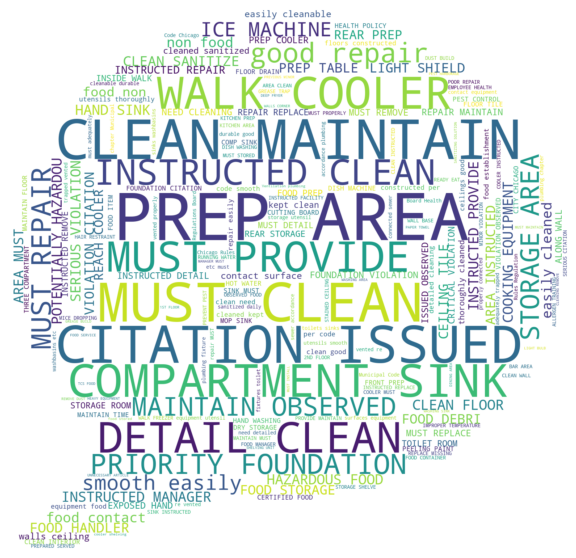

In [452]:

#plt.rcParams['figure.figsize'] = (20, 10)

plt.imshow(comments_wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
def print_new_rules():

    url = "https://www.chicago.gov/city/en/depts/cdph/provdrs/healthy_restaurants/svcs/understand_healthcoderequirementsforfoodestablishments.html"
    html_content = requests.get(url).text
    soup = BeautifulSoup(html_content, "html.parser")
    all_ps = []
    for p in soup.find_all('p'):
        all_ps.append(p.text)
    new_rules = [x.strip('01234567789\xa0 ') for x in all_ps if len(x) > 0 and x[0] >= '1' and x[0] <= '9']
    for i, r in enumerate(new_rules):
        print('"v' + str(i + 1) + '":' , '"' + r +  ' (' + str(i + 1) + ')'  + '",')
        
print_new_rules()

In [ ]:
# https://www.chicago.gov/city/en/depts/cdph/provdrs/healthy_restaurants/svcs/understand_healthcoderequirementsforfoodestablishments.html
# https://webapps1.chicago.gov/healthinspection/Code_Violations.jsp#summary
# https://www.chicago.gov/content/dam/city/depts/cdph/FoodProtection/ChicagoFoodCodeMajorChangesFinal2018.pdf
# https://data.cityofchicago.org/Health-Human-Services/Food-Inspections/4ijn-s7e5
# http://dev.cityofchicago.org/open%20data/data%20portal/2018/06/29/food-violations-changes.html
# https://www.chicago.gov/city/en/depts/cdph/provdrs/healthy_restaurants/svcs/food-protection-services.html
# https://data.cityofchicago.org/api/assets/BAD5301B-681A-4202-9D25-51B2CAE672FF

In [12]:
with open('data/community_areas.geojson') as f:
    community_areas_geojson = json.load(f)

In [13]:
community_areas = []
for i in range(len(community_areas_geojson['features'])):
    community_area = community_areas_geojson['features'][i]['properties']['community']
    community_areas.append(community_area)
    community_areas_geojson['features'][i]['id'] = community_area


    
fig = go.Figure(go.Choroplethmapbox(geojson=community_areas_geojson, locations = community_areas, z= [100] + [5] * (len(community_areas_geojson['features']) - 1),
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))


fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

iplot(fig)
    

In [14]:
def get_nearest_neigh(point, geo_df):
    idx = geo_df.geometry.distance(point).idxmin()
    return geo_df.loc[idx, 'community']

## key: key that will be used to join
def assign_community(geo_df, data, latitude="Latitude", longitude="Longitude", verbose=False):
    geometry = [Point(x, y) for x, y in zip(data[longitude], data[latitude])]
    crs = {'init': 'epsg:4326'}
    data_to_join = gpd.GeoDataFrame(data, 
                                       crs=crs,
                                       geometry=geometry)
    points_to_neigh = sjoin(data_to_join, geo_df, how='left')
    
    neigh_not_found = points_to_neigh[pd.isna(points_to_neigh['community'])]
    
    if verbose:
        print("There are {} points without an exact neighborhood".format(len(neigh_not_found)))
    
    neigh_not_found['community'] = neigh_not_found.copy().geometry.apply(get_nearest_neigh, geo_df=geo_df)
    points_to_neigh.loc[neigh_not_found.index] = neigh_not_found
    
    if verbose:
        print("There are {} points without an exact neighborhood"\
              .format(len(points_to_neigh[pd.isna(points_to_neigh['community'])])))
    
    columns_to_return = list(data.columns) + ["community"]
    return points_to_neigh[columns_to_return]

In [15]:
geo_df = gpd.read_file("data/community_areas.geojson")

In [16]:
inspections_community = assign_community(geo_df, inspections, verbose=True)

There are 1806 points without an exact neighborhood
There are 0 points without an exact neighborhood


D:\murat\Anaconda3\envs\ada\lib\site-packages\ipykernel_launcher.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
n_inspections = inspections_community['community'].value_counts()


In [18]:
fig = go.Figure(go.Choroplethmapbox(geojson=community_areas_geojson,
                                    locations = n_inspections.index,
                                    z= n_inspections.values,
                                    autocolorscale = True,
                                    #text = n_inspections.apply(lambda x: '# of Inspections: ' + str(x)).values,
                                    #colorscale="Viridis",
                                    #hoverinfo = 'location+text',
                                    marker_opacity=0.5, marker_line_width=0))


fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=9, mapbox_center = {"lat": 41.8523, "lon": -87.6660})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})



#fig.update_layout(scrollZoom = False)

fig.update_layout(updatemenus=[        
         go.layout.Updatemenu(
                #type = "buttons",
                #direction = "left",
                
                buttons=list([
                    dict(
                        args=["z", n_inspections.values / 500],
                        #args2 = ['maxdepth', 3],
                        label="Toggle LOD",
                        method = 'update',
                    ),

                ]),
                #pad={"r": 10, "t": 10},
                showactive=False,
                x=-0.01,
                xanchor="right",
                y=0.85,
                yanchor="top",
                #valign = "top"
            ),
        

        
        
            
        
    ],  annotations=[
            #go.layout.Annotation(text="Year:", showarrow=False,
            #                     x=0, y=-0.12, yref="paper", align="left"),
        
            #go.layout.Annotation(text="Depth:", showarrow=False,
            #                     x=-0.16, y=0.74, yref="paper", align="left"),
        
            #go.layout.Annotation(text="Year:", showarrow=False,
            #                     x=-0.23, y=0.96, yref="paper", align="left"),
        ])



iplot(fig,
      #config={'scrollZoom': False}
     )

In [26]:
def generate_map(location, z_vals):
    return go.Choroplethmapbox(geojson=community_areas_geojson,
                                    locations = location,
                                    z= z_vals,
                                    autocolorscale = True,
                                    #text = n_inspections.apply(lambda x: '# of Inspections: ' + str(x)).values,
                                    #colorscale="Viridis",
                                    hoverinfo = 'location+text',
                                    marker_opacity=0.5, marker_line_width=0)




def create_map_traces():

    traces = []
    
    
    #ADD WHATEVER MAP  YOU WANT TO ADD HERE LIKE THESE TWO LINES
    traces.append(generate_map(n_inspections.index, n_inspections.values / 1000))
    traces.append(generate_map(n_inspections.index, n_inspections.values))
    
    
    return traces
    


map_traces = create_map_traces()

In [28]:
#DECIDE THE LABELS OF THE BUTTONS HERE KEEPING IT CONSISTENT WITH THE NUMBER OF MAPS
def create_map_buttons(button_labels = ['inspections / 1000', '# of Inspections', ]):

    buttons =[]
    for i in range(len(button_labels)):
        visible_vector = [False] * len(button_labels)
        visible_vector[i] = True
        
        dict_obj =  dict(label = button_labels[i],
                         method = 'update',
                         args = [{'visible': visible_vector } ,
                             #{'title': 'Yahoo High'},
                            ] )
        buttons.append(dict_obj)
    return buttons


In [29]:
def draw_map():
    fig = go.Figure()
    
    #2010-2018old 2018new 2019new alltimeold alltimenew
    for trace in map_traces:
        fig.add_trace(trace)

    
    dropdown_buttons = create_map_buttons()
    
    fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=9, mapbox_center = {"lat": 41.8523, "lon": -87.6660})
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    
    fig.update_layout(updatemenus=[
        go.layout.Updatemenu(
             #type="buttons",
             active = len(dropdown_buttons) - 1,
             buttons=list(dropdown_buttons),
             showactive=True,
             x = -0.01,
             y = 1,
              xanchor = 'right',
              yanchor = 'top'
            )])
        
    iplot(fig,
         #config={'scrollZoom': False}
         )

draw_map()

In [567]:
lat_lon_grouped = inspections.groupby(['Latitude', 'Longitude']).size()

fig = go.Figure(go.Densitymapbox(lat=lat_lon_grouped.index.get_level_values(0),
                                 lon=lat_lon_grouped.index.get_level_values(1),
                                 z = lat_lon_grouped.values,
                                 radius=20,
                                 showscale = False
                                ))
fig.update_layout(mapbox_style="carto-positron", mapbox_center_lon=180)
#fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
iplot(fig)




In [548]:
lat_lon_grouped.values.max()

1682